In [103]:
import pandas as pd
import numpy as np
import missingno as msno
import re
from nltk.stem.snowball import SnowballStemmer

from nltk import tokenize

In [21]:
pd.options.display.max_rows
pd.set_option('display.max_colwidth', -1)

/Users/colinsimon/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  


In [3]:
tweets1 = pd.read_csv('./data/train.csv')

In [55]:
tweettest = pd.read_csv('./data/test.csv')

In [22]:
tweets1

,id,keyword,location,text,target
0,1,NaN,NaN,Our Deeds are the Reason of this #earthquake May ALLAH Forgive us all,1
1,4,NaN,NaN,Forest fire near La Ronge Sask. Canada,1
2,5,NaN,NaN,All residents asked to 'shelter in place' are being notified by officers. No other evacuation or shelter in place orders are expected,1
3,6,NaN,NaN,"13,000 people receive #wildfires evacuation orders in California",1
4,7,NaN,NaN,Just got sent this photo from Ruby #Alaska as smoke from #wildfires pours into a school,1
5,8,NaN,NaN,#RockyFire Update => California Hwy. 20 closed in both directions due to Lake County fire - #CAfire #wildfires,1
6,10,NaN,NaN,"#flood #disaster Heavy rain causes flash flooding of streets in Manitou, Colorado Springs areas",1
7,13,NaN,NaN,I'm on top of the hill and I can see a fire in the woods...,1
8,14,NaN,NaN,There's an emergency evacuation happening now in the building across the street,1
9,15,NaN,NaN,I'm afraid that the tornado is coming to our area...,1


In [17]:
tweets1['text'][4]

'Just got sent this photo from Ruby #Alaska as smoke from #wildfires pours into a school '

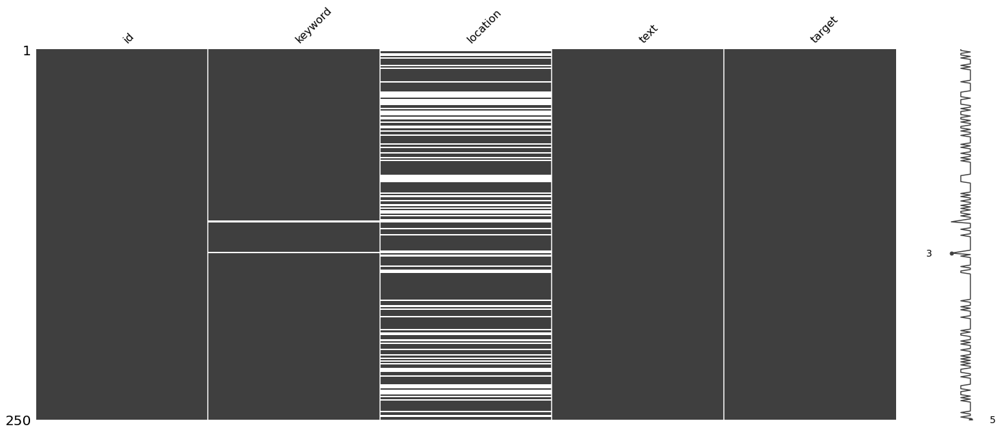

In [9]:
msno.matrix(tweets1.sample(250));

In [10]:
tweets1.isna().sum()

id             0
keyword       61
location    2533
text           0
target         0
dtype: int64

In [99]:
keywords = tweets1['keyword'].unique()

In [36]:
keyword_counts = tweets1['keyword'].value_counts()

In [41]:
keyword_counts.sort_values(ascending=False)

fatalities               45
armageddon               42
deluge                   42
harm                     41
damage                   41
body%20bags              41
sinking                  41
twister                  40
outbreak                 40
fear                     40
evacuate                 40
siren                    40
windstorm                40
collided                 40
weapon                   39
explosion                39
flames                   39
earthquake               39
collision                39
wrecked                  39
whirlwind                39
wreckage                 39
sunk                     39
famine                   39
weapons                  39
derailment               39
sinkhole                 39
hellfire                 39
deaths                   38
hurricane                38
ambulance                38
drowned                  38
thunder                  38
upheaval                 38
flooding                 38
fatal               

In [100]:
keywords_sorted = []
for i in keywords:
    keywords_sorted.append(i)

In [101]:
keywords_sorted

[nan,
 'ablaze',
 'accident',
 'aftershock',
 'airplane%20accident',
 'ambulance',
 'annihilated',
 'annihilation',
 'apocalypse',
 'armageddon',
 'army',
 'arson',
 'arsonist',
 'attack',
 'attacked',
 'avalanche',
 'battle',
 'bioterror',
 'bioterrorism',
 'blaze',
 'blazing',
 'bleeding',
 'blew%20up',
 'blight',
 'blizzard',
 'blood',
 'bloody',
 'blown%20up',
 'body%20bag',
 'body%20bagging',
 'body%20bags',
 'bomb',
 'bombed',
 'bombing',
 'bridge%20collapse',
 'buildings%20burning',
 'buildings%20on%20fire',
 'burned',
 'burning',
 'burning%20buildings',
 'bush%20fires',
 'casualties',
 'casualty',
 'catastrophe',
 'catastrophic',
 'chemical%20emergency',
 'cliff%20fall',
 'collapse',
 'collapsed',
 'collide',
 'collided',
 'collision',
 'crash',
 'crashed',
 'crush',
 'crushed',
 'curfew',
 'cyclone',
 'damage',
 'danger',
 'dead',
 'death',
 'deaths',
 'debris',
 'deluge',
 'deluged',
 'demolish',
 'demolished',
 'demolition',
 'derail',
 'derailed',
 'derailment',
 'desolate'

In [23]:
tweets1[['keyword']].isna().count()

keyword    7613
dtype: int64

In [24]:
tweets1.count()

id          7613
keyword     7552
location    5080
text        7613
target      7613
dtype: int64

In [64]:
tweets1[tweets1['text'].str.contains('burners')]

,id,keyword,location,text,target


In [56]:
tweettest

,id,keyword,location,text
0,0,NaN,NaN,Just happened a terrible car crash
1,2,NaN,NaN,"Heard about #earthquake is different cities, stay safe everyone."
2,3,NaN,NaN,"there is a forest fire at spot pond, geese are fleeing across the street, I cannot save them all"
3,9,NaN,NaN,Apocalypse lighting. #Spokane #wildfires
4,11,NaN,NaN,Typhoon Soudelor kills 28 in China and Taiwan
5,12,NaN,NaN,We're shaking...It's an earthquake
6,21,NaN,NaN,"They'd probably still show more life than Arsenal did yesterday, eh? EH?"
7,22,NaN,NaN,Hey! How are you?
8,27,NaN,NaN,What a nice hat?
9,29,NaN,NaN,Fuck off!


In [72]:
a = 'SETTING MYSELF ABLAZE https://t.co/6vMe7P5XhC'
b = a.replace('https://','')
c = b.replace('http://','')
d = c.replace('t.co/','')
print(d)

SETTING MYSELF ABLAZE 6vMe7P5XhC


In [73]:
e = "'Burning Rahm': Let's hope City Hall builds a giant wooden mayoral effigy 100 feet tall &amp; sets it ablaze. http://t.co/kFo2mksn6Y @John_Kass"

In [75]:
f = e.rfind('http')
print(f)

110


In [76]:
h = 'hello how are you'
g = f.replace([10:15])

SyntaxError: invalid syntax (<ipython-input-76-4af715452bb3>, line 2)

In [81]:
i = "I liked a @YouTube video http://t.co/jrFjgaAc9F Minecraft: NIGHT LUCKY BLOCK MOD (BOB APOCALYPSE WITHER 2.0 &amp; MORE!) Mod Showcase"

In [92]:
# Using this string remover from StackOverflow: 
# https://stackoverflow.com/questions/11331982/how-to-remove-any-url-within-a-string-in-python
URLless_string = re.sub(r'\w+:\/{2}[\d\w-]+(\.[\d\w-]+)*(?:(?:\/[^\s/]*))*', '', i)
print(URLless_string)

I liked a @YouTube video  Minecraft: NIGHT LUCKY BLOCK MOD (BOB APOCALYPSE WITHER 2.0 &amp; MORE!) Mod Showcase


In [94]:
tweets1['text_no_url'] = [re.sub(r'\w+:\/{2}[\d\w-]+(\.[\d\w-]+)*(?:(?:\/[^\s/]*))*', '', i) for i in tweets1['text']]

In [95]:
tweets1

,id,keyword,location,text,target,text_no_url
0,1,NaN,NaN,Our Deeds are the Reason of this #earthquake May ALLAH Forgive us all,1,Our Deeds are the Reason of this #earthquake May ALLAH Forgive us all
1,4,NaN,NaN,Forest fire near La Ronge Sask. Canada,1,Forest fire near La Ronge Sask. Canada
2,5,NaN,NaN,All residents asked to 'shelter in place' are being notified by officers. No other evacuation or shelter in place orders are expected,1,All residents asked to 'shelter in place' are being notified by officers. No other evacuation or shelter in place orders are expected
3,6,NaN,NaN,"13,000 people receive #wildfires evacuation orders in California",1,"13,000 people receive #wildfires evacuation orders in California"
4,7,NaN,NaN,Just got sent this photo from Ruby #Alaska as smoke from #wildfires pours into a school,1,Just got sent this photo from Ruby #Alaska as smoke from #wildfires pours into a school
5,8,NaN,NaN,#RockyFire Update => California Hwy. 20 closed in both directions due to Lake County fire - #CAfire #wildfires,1,#RockyFire Update => California Hwy. 20 closed in both directions due to Lake County fire - #CAfire #wildfires
6,10,NaN,NaN,"#flood #disaster Heavy rain causes flash flooding of streets in Manitou, Colorado Springs areas",1,"#flood #disaster Heavy rain causes flash flooding of streets in Manitou, Colorado Springs areas"
7,13,NaN,NaN,I'm on top of the hill and I can see a fire in the woods...,1,I'm on top of the hill and I can see a fire in the woods...
8,14,NaN,NaN,There's an emergency evacuation happening now in the building across the street,1,There's an emergency evacuation happening now in the building across the street
9,15,NaN,NaN,I'm afraid that the tornado is coming to our area...,1,I'm afraid that the tornado is coming to our area...


In [98]:
tweets1[tweets1['text'].str.contains('India')]

,id,keyword,location,text,target,text_no_url
362,520,army,Pakistan,.: .: .: .: .: .: .: .: .: .: .: .: .: .: .: .: .: .: .: .: .: RT DrAyesha4: #IndiaKoMunTorJawabDo\n\nIndian Army kiÛ_ http://t.co/WJLJq3yA4g,0,.: .: .: .: .: .: .: .: .: .: .: .: .: .: .: .: .: .: .: .: .: RT DrAyesha4: #IndiaKoMunTorJawabDo\n\nIndian Army kiÛ_
471,681,attack,Mumbai,India shud not give any evidence 2 pak.They will share with terrorists &amp; use for next attack.Share with oth contries https://t.co/qioPbTIUVu,1,India shud not give any evidence 2 pak.They will share with terrorists &amp; use for next attack.Share with oth contries
915,1324,bloody,Isolated City In World Perth,'I came to kill Indians...for FUN': Video of smirking and remorseless Pakistani killer shows him boasting. http://t.co/FPjLwOXKlg,1,'I came to kill Indians...for FUN': Video of smirking and remorseless Pakistani killer shows him boasting.
1600,2309,collapse,"Kolkata, India",Warne Ponting shocked by Australian collapse - Yahoo Cricket India https://t.co/hsgkTeZUCN,0,Warne Ponting shocked by Australian collapse - Yahoo Cricket India
1710,2466,collided,NaN,Monsoon flooding - Monsoon rains have have hit India Pakistan and Myanmar hard this season. Two trains collided ... http://t.co/A7zF6N7vrL,1,Monsoon flooding - Monsoon rains have have hit India Pakistan and Myanmar hard this season. Two trains collided ...
1712,2468,collided,"St. Joseph, Minnesota",Two trains have collided in India. Please pray for victims their families and rescuers.,1,Two trains have collided in India. Please pray for victims their families and rescuers.
1780,2555,crash,NaN,MotoGP Indianapolis: Espargaro: Layout 'worries me a little' - http://t.co/RNy4l3sr7a http://t.co/igX8XFz8Ko,0,MotoGP Indianapolis: Espargaro: Layout 'worries me a little' -
2033,2917,danger,Lahar & Gwalior,Indian Govt. &amp; Media should take serious concern about their safety. They are in danger now. https://t.co/YX1UKbmTqB,1,Indian Govt. &amp; Media should take serious concern about their safety. They are in danger now.
2164,3105,debris,NaN,Malaysia Airlines Flight 370 that Disappeared 17months ago Debris Found South of The Indian Ocean - http://t.co/nrHURYSyPd,1,Malaysia Airlines Flight 370 that Disappeared 17months ago Debris Found South of The Indian Ocean -
2373,3412,derail,NaN,BBC News - India rail crash: Trains derail in Madhya Pradesh flash flood http://t.co/WgmZmJ5imD,1,BBC News - India rail crash: Trains derail in Madhya Pradesh flash flood


In [106]:
stemmer = SnowballStemmer('english')
keyword_stem = stemmer.stem(tweets1['keyword'])

AttributeError: 'Series' object has no attribute 'lower'

In [ ]:
tweets1['keyword_stem'] = tweets1['keyword']

In [ ]:
comp = list(zip(keywords_lem, keywords_sorted))
for i in comp:
    if i[0] != i[1]:
        print(i)

In [108]:
tweets1['keyword'].fillna(value='-', inplace=True)

In [109]:
tweets1['keywords_stemmed'] = tweets1['keyword'].map(lambda x: stemmer.stem(x))

In [110]:
tweets1

,id,keyword,location,text,target,text_no_url,keywords_stemmed
0,1,-,NaN,Our Deeds are the Reason of this #earthquake May ALLAH Forgive us all,1,Our Deeds are the Reason of this #earthquake May ALLAH Forgive us all,-
1,4,-,NaN,Forest fire near La Ronge Sask. Canada,1,Forest fire near La Ronge Sask. Canada,-
2,5,-,NaN,All residents asked to 'shelter in place' are being notified by officers. No other evacuation or shelter in place orders are expected,1,All residents asked to 'shelter in place' are being notified by officers. No other evacuation or shelter in place orders are expected,-
3,6,-,NaN,"13,000 people receive #wildfires evacuation orders in California",1,"13,000 people receive #wildfires evacuation orders in California",-
4,7,-,NaN,Just got sent this photo from Ruby #Alaska as smoke from #wildfires pours into a school,1,Just got sent this photo from Ruby #Alaska as smoke from #wildfires pours into a school,-
5,8,-,NaN,#RockyFire Update => California Hwy. 20 closed in both directions due to Lake County fire - #CAfire #wildfires,1,#RockyFire Update => California Hwy. 20 closed in both directions due to Lake County fire - #CAfire #wildfires,-
6,10,-,NaN,"#flood #disaster Heavy rain causes flash flooding of streets in Manitou, Colorado Springs areas",1,"#flood #disaster Heavy rain causes flash flooding of streets in Manitou, Colorado Springs areas",-
7,13,-,NaN,I'm on top of the hill and I can see a fire in the woods...,1,I'm on top of the hill and I can see a fire in the woods...,-
8,14,-,NaN,There's an emergency evacuation happening now in the building across the street,1,There's an emergency evacuation happening now in the building across the street,-
9,15,-,NaN,I'm afraid that the tornado is coming to our area...,1,I'm afraid that the tornado is coming to our area...,-


In [115]:
tweets1['keywords_stemmed'].value_counts()

fatal                   120
evacu                   112
derail                  112
flood                   109
body%20bag              107
scream                  105
drown                   104
bomb                    101
hijack                  100
suicide%20bomb          99 
obliter                 91 
weapon                  78 
wreck                   76 
collid                  74 
death                   74 
blaze                   72 
injuri                  71 
quarantin               71 
attack                  71 
explod                  71 
wound                   70 
casualti                69 
delug                   69 
destroy                 69 
riot                    69 
hazard                  69 
collaps                 69 
siren                   69 
crush                   68 
hostag                  68 
deton                   68 
burn                    67 
bioterror               67 
devast                  67 
crash                   67 
electrocut          

In [116]:
tweets1['keywords_stemmed'].nunique()

167